<h1><center>19AIE304</center></h1>
<h2><center>BDMS PROJECT</center></h2>
<h2><center>ANALYSIS ZOMATO DATASET</center></h2>

### BY:
#### &emsp; &emsp; P. ADHITHAN &emsp; &emsp;  CB.EN.U4AIE19003
#### &emsp; &emsp; S. DINESH &emsp;  &emsp; &emsp;  CB.EN.U4AIE19025
#### &emsp; &emsp; N. KABILAN &nbsp; &emsp; &emsp;  CB.EN.U4AIE19033
#### &emsp; &emsp; P. SHANKAR &nbsp;  &emsp; &emsp;  CB.EN.U4AIE19051
    

<h2><center> MONGODB </center></h2> 

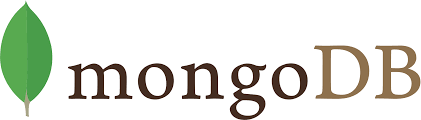
 ##### MongoDB is a source-available cross-platform document-oriented database program. 
 ##### Classified as a NoSQL database program, MongoDB uses JSON-like documents with optional schemas.
 ##### MongoDB is a distributed database at its core.

#### PYMONGO
##### PyMongo is a Python distribution containing tools for working with MongoDB, and is the recommended way to work with MongoDB from Python.

### ABOUT DATASET

#### 
   - <b> url </b>:  contains the url of the restaurant in the zomato website

   - <b> address </b> :  contains the address of the restaurant in Bengaluru

   - <b> name </b>:  contains the name of the restaurant

   - <b> online_order </b> :  whether online ordering is available in the restaurant or not

   - <b> book_table</b> :  table book option available or not

   - <b> rate </b> :  contains the overall rating of the restaurant out of 5

   - <b> votes </b> :  contains total number of rating for the restaurant as of the above mentioned date

   - <b> phone </b> :  contains the phone number of the restaurant

   - <b> location </b> :  contains the neighborhood in which the restaurant is located

   - <b> rest_type </b> :  restaurant type

   - <b> dish_liked </b> :  dishes people liked in the restaurant

   - <b> cuisines </b> :  food styles, separated by comma

   - <b> approx_cost(for two people) </b> :  contains the approximate cost for meal for two people

   - <b> reviews_list </b> :  list of tuples containing reviews for the restaurant, each tuple consists of two values, rating and review by the customer
 
   - <b> menu_item </b> :  contains list of menus available in the restaurant

   - <b> listed_in(type) </b> :  type of meal

   - <b> listed_in(city) </b> :  contains the neighborhood in which the restaurant is listed

####  

#### IMPORTING PACKAGES

##### FOR ACCESSING CLIENT

In [1]:
import pymongo
from pymongo import MongoClient 
    
# Connect with the portnumber and host  
client = MongoClient("mongodb://localhost:27017/")  


##### FOR PREPROCESSING

In [2]:
import pandas as pd
import json
import numpy as np

In [40]:
import matplotlib.pyplot as plt
import plotly.offline as pyo
from matplotlib import style
from plotly.offline import init_notebook_mode, plot ,iplot
plt.rcParams['figure.figsize'] = 17,7
style.use("ggplot")
pyo.init_notebook_mode(connected=True)


#### READING AND ANALYSING THE DATASET

##### READING DATASET

In [3]:
data= pd.read_csv("zomato.csv")
data.head()

,url,address,name,online_order,book_table,rate,votes,phone,location,rest_type,dish_liked,cuisines,approx_cost(for two people),reviews_list,menu_item,listed_in(type),listed_in(city)
0,https://www.zomato.com/bangalore/jalsa-banasha...,"942, 21st Main Road, 2nd Stage, Banashankari, ...",Jalsa,Yes,Yes,4.1/5,775,080 42297555\r\n+91 9743772233,Banashankari,Casual Dining,"Pasta, Lunch Buffet, Masala Papad, Paneer Laja...","North Indian, Mughlai, Chinese",800,"[('Rated 4.0', 'RATED\n A beautiful place to ...",[],Buffet,Banashankari
1,https://www.zomato.com/bangalore/spice-elephan...,"2nd Floor, 80 Feet Road, Near Big Bazaar, 6th ...",Spice Elephant,Yes,No,4.1/5,787,080 41714161,Banashankari,Casual Dining,"Momos, Lunch Buffet, Chocolate Nirvana, Thai G...","Chinese, North Indian, Thai",800,"[('Rated 4.0', 'RATED\n Had been here for din...",[],Buffet,Banashankari
2,https://www.zomato.com/SanchurroBangalore?cont...,"1112, Next to KIMS Medical College, 17th Cross...",San Churro Cafe,Yes,No,3.8/5,918,+91 9663487993,Banashankari,"Cafe, Casual Dining","Churros, Cannelloni, Minestrone Soup, Hot Choc...","Cafe, Mexican, Italian",800,"[('Rated 3.0', ""RATED\n Ambience is not that ...",[],Buffet,Banashankari
3,https://www.zomato.com/bangalore/addhuri-udupi...,"1st Floor, Annakuteera, 3rd Stage, Banashankar...",Addhuri Udupi Bhojana,No,No,3.7/5,88,+91 9620009302,Banashankari,Quick Bites,Masala Dosa,"South Indian, North Indian",300,"[('Rated 4.0', ""RATED\n Great food and proper...",[],Buffet,Banashankari
4,https://www.zomato.com/bangalore/grand-village...,"10, 3rd Floor, Lakshmi Associates, Gandhi Baza...",Grand Village,No,No,3.8/5,166,+91 8026612447\r\n+91 9901210005,Basavanagudi,Casual Dining,"Panipuri, Gol Gappe","North Indian, Rajasthani",600,"[('Rated 4.0', 'RATED\n Very good restaurant ...",[],Buffet,Banashankari


##### CONVERTING TO JSON

In [4]:
json_data = json.loads(data.to_json(orient='records'))

##### ACCESSING DATABASE

In [5]:
dblist=client.list_database_names()
dblist

['admin',
 'bdmszomo',
 'books',
 'config',
 'departmentcategories',
 'local',
 'movies']

In [6]:
# Access database  
mydb = client['bdmszomo'] 
collection = mydb['zomo']

In [7]:
collection.remove()
collection.insert_many(json_data)

<ipython-input-7-1bcba729b629>:1: DeprecationWarning: remove is deprecated. Use delete_one or delete_many instead.
  collection.remove()


##### DATASET

In [8]:
list(collection.find())

[{'_id': ObjectId('619b5fac486e6853175307ca'),
  'url': 'https://www.zomato.com/bangalore/jalsa-banashankari?context=eyJzZSI6eyJlIjpbNTg2OTQsIjE4Mzc1NDc0IiwiNTkwOTAiLCIxODM4Mjk0NCIsIjE4MjI0Njc2IiwiNTkyODkiLCIxODM3MzM4NiJdLCJ0IjoiUmVzdGF1cmFudHMgaW4gQmFuYXNoYW5rYXJpIHNlcnZpbmcgQnVmZmV0In19',
  'address': '942, 21st Main Road, 2nd Stage, Banashankari, Bangalore',
  'name': 'Jalsa',
  'online_order': 'Yes',
  'book_table': 'Yes',
  'rate': '4.1/5',
  'votes': 775,
  'phone': '080 42297555\r\n+91 9743772233',
  'location': 'Banashankari',
  'rest_type': 'Casual Dining',
  'dish_liked': 'Pasta, Lunch Buffet, Masala Papad, Paneer Lajawab, Tomato Shorba, Dum Biryani, Sweet Corn Soup',
  'cuisines': 'North Indian, Mughlai, Chinese',
  'approx_cost(for two people)': '800',
  'reviews_list': '[(\'Rated 4.0\', \'RATED\\n  A beautiful place to dine in.The interiors take you back to the Mughal era. The lightings are just perfect.We went there on the occasion of Christmas and so they had only limite

In [9]:
# preprocessing some values
collection.update_many({},[{"$set": {"approx_cost(for two people)": {"$convert":{"input" : "$approx_cost(for two people)", "to":"int", "onError":"$approx_cost(for two people)", "onNull": None}}}}])

In [22]:
# checking for changes
list(collection.find())

[{'_id': ObjectId('619b5160b3ebd7364e5bf5d4'),
  'url': 'https://www.zomato.com/bangalore/jalsa-banashankari?context=eyJzZSI6eyJlIjpbNTg2OTQsIjE4Mzc1NDc0IiwiNTkwOTAiLCIxODM4Mjk0NCIsIjE4MjI0Njc2IiwiNTkyODkiLCIxODM3MzM4NiJdLCJ0IjoiUmVzdGF1cmFudHMgaW4gQmFuYXNoYW5rYXJpIHNlcnZpbmcgQnVmZmV0In19',
  'address': '942, 21st Main Road, 2nd Stage, Banashankari, Bangalore',
  'name': 'Jalsa',
  'online_order': 'Yes',
  'book_table': 'Yes',
  'rate': '4.1/5',
  'votes': 775,
  'phone': '080 42297555\r\n+91 9743772233',
  'location': 'Banashankari',
  'rest_type': 'Casual Dining',
  'dish_liked': 'Pasta, Lunch Buffet, Masala Papad, Paneer Lajawab, Tomato Shorba, Dum Biryani, Sweet Corn Soup',
  'cuisines': 'North Indian, Mughlai, Chinese',
  'approx_cost(for two people)': 800,
  'reviews_list': '[(\'Rated 4.0\', \'RATED\\n  A beautiful place to dine in.The interiors take you back to the Mughal era. The lightings are just perfect.We went there on the occasion of Christmas and so they had only limited 

### 0. Number of hotels in Bangalore

In [16]:
q0_agg_result=collection.aggregate([{ "$group": {"_id": "$name", "count": { "$sum": 1 } } }])

In [15]:
len(list(q0_agg_result))

8792

#### Inference
    - From this we can get number of food spots in Banglore which is in collaboration with Zomato......  

### 1. Number of orders in each Location

In [27]:
q1_agg_result=collection.aggregate([{ "$group": {"_id": "$listed_in(city)", "count": { "$sum": 1 } } },
                                 {"$sort": { "count": -1 } }])


In [24]:
list(q1_agg_result)

[{'_id': 'BTM', 'count': 3279},
 {'_id': 'Koramangala 7th Block', 'count': 2938},
 {'_id': 'Koramangala 5th Block', 'count': 2836},
 {'_id': 'Koramangala 4th Block', 'count': 2779},
 {'_id': 'Koramangala 6th Block', 'count': 2623},
 {'_id': 'Jayanagar', 'count': 2371},
 {'_id': 'JP Nagar', 'count': 2096},
 {'_id': 'Indiranagar', 'count': 1860},
 {'_id': 'Church Street', 'count': 1827},
 {'_id': 'MG Road', 'count': 1811},
 {'_id': 'Brigade Road', 'count': 1769},
 {'_id': 'Lavelle Road', 'count': 1744},
 {'_id': 'HSR', 'count': 1741},
 {'_id': 'Marathahalli', 'count': 1659},
 {'_id': 'Residency Road', 'count': 1620},
 {'_id': 'Whitefield', 'count': 1620},
 {'_id': 'Bannerghatta Road', 'count': 1617},
 {'_id': 'Brookefield', 'count': 1518},
 {'_id': 'Old Airport Road', 'count': 1425},
 {'_id': 'Kammanahalli', 'count': 1329},
 {'_id': 'Kalyan Nagar', 'count': 1309},
 {'_id': 'Basavanagudi', 'count': 1266},
 {'_id': 'Sarjapur Road', 'count': 1261},
 {'_id': 'Electronic City', 'count': 1229}

In [28]:
df = pd.DataFrame(q1_agg_result)
df

,_id,count
0,BTM,3279
1,Koramangala 7th Block,2938
2,Koramangala 5th Block,2836
3,Koramangala 4th Block,2779
4,Koramangala 6th Block,2623
5,Jayanagar,2371
6,JP Nagar,2096
7,Indiranagar,1860
8,Church Street,1827
9,MG Road,1811


<AxesSubplot:xlabel='_id'>

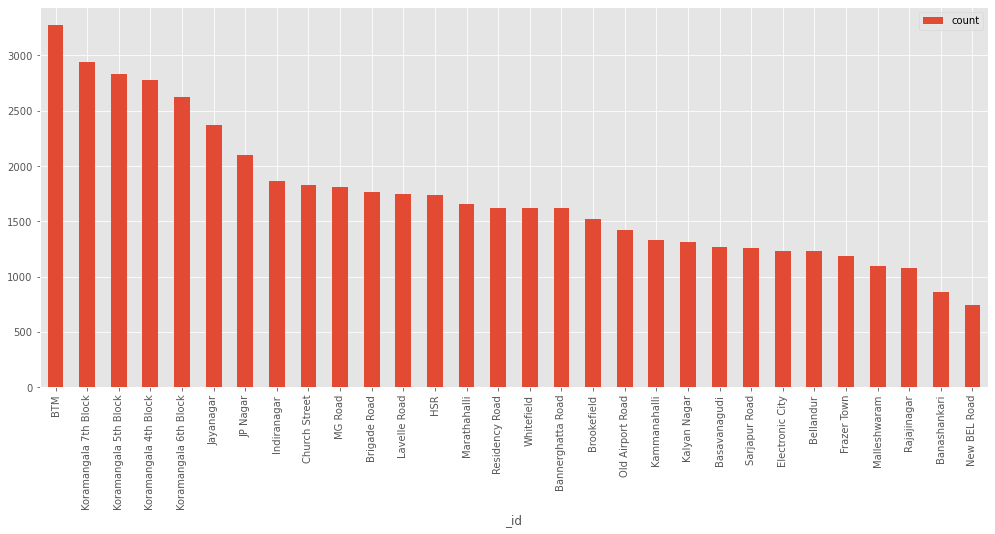

In [35]:
df.plot(kind = 'bar',x = '_id', y = 'count')

#### i. Top 5 Locations

In [36]:
q1_agg_result_1=collection.aggregate([{ "$group": {"_id": "$listed_in(city)", "count": { "$sum": 1 } } },
                                 {"$sort": { "count": -1 } },
                                {"$limit": 5}])
list(q1_agg_result_1)

[{'_id': 'BTM', 'count': 3279},
 {'_id': 'Koramangala 7th Block', 'count': 2938},
 {'_id': 'Koramangala 5th Block', 'count': 2836},
 {'_id': 'Koramangala 4th Block', 'count': 2779},
 {'_id': 'Koramangala 6th Block', 'count': 2623}]

#### ii. Last 5 Locations 

In [37]:
q1_agg_result_2=collection.aggregate([{ "$group": {"_id": "$listed_in(city)", "count": { "$sum": 1 } } },
                                 {"$sort": { "count": 1 } },
                                   {"$limit": 5}])
list(q1_agg_result_2)

[{'_id': 'New BEL Road', 'count': 740},
 {'_id': 'Banashankari', 'count': 863},
 {'_id': 'Rajajinagar', 'count': 1079},
 {'_id': 'Malleshwaram', 'count': 1096},
 {'_id': 'Frazer Town', 'count': 1185}]

#### Inference
    - Sales in each Area.
    - Food Consumption in each Area. 
    - People in BTM, Koramangala 4th,5th,6th,7th Block, Jayanagar are ordering more in Zomato... whereas  New BEL Road , Banashankari counts less number of orders.

### 2. Liked Dishes

In [29]:
q2=[]
for rec in collection.find({'dish_liked':{'$ne':None}}):
    q2.append(rec.get('dish_liked'))

In [31]:
from functools import reduce
q2flatlist = reduce(lambda a,b:a+b, q2)
q2flatlist=q2flatlist.split(", ")
dfq2 = pd.DataFrame({'food':q2flatlist})
x=(dfq2['food'].value_counts())
x=x.to_frame()
x=x.set_axis(['no. of counts'], axis=1, inplace=False)


In [32]:
x

,no. of counts
Pasta,2350
Cocktails,1769
Pizza,1680
Burgers,1522
Mocktails,1413
...,...
Raj KachoriAndhra Thali,1
Garlic RiceAloo Paratha,1
Palak PaneerPot Biryani,1
Spicy Paneer PizzaPaneer Tikka,1


<AxesSubplot:ylabel='no. of counts'>

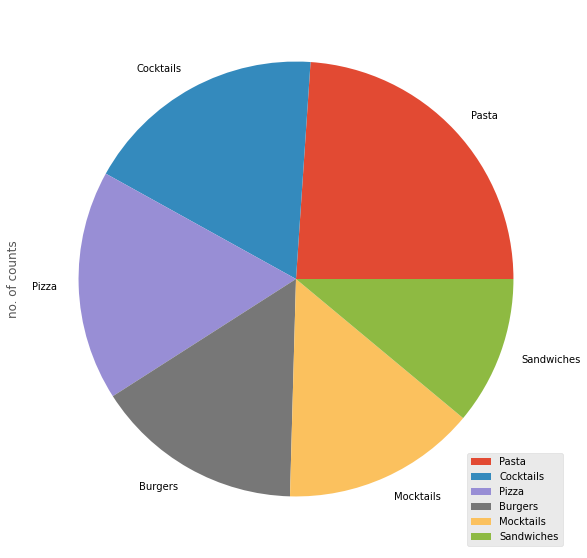

In [41]:
x[0:6].plot(kind = 'pie',y = 'no. of counts', figsize=(10, 10))

#### i. Top 5 Dishes

In [42]:
x.head(5)

,no. of counts
Pasta,2350
Cocktails,1769
Pizza,1680
Burgers,1522
Mocktails,1413


#### ii. Last 5 Dishes

In [43]:
x.tail(5)

,no. of counts
ShawarmaNaan,1
NaanKulcha,1
Gundappa Donne BiryaniMasala Poori,1
Kalmi KebabCustard,1
MaggiGulab Jamun,1


#### Inference
        - Sales of Dishes
        - Which dish is liked by more people.
        - Pasta, Cocktails, Pizza are liked by most of the people whereas Salted CaramelRasgulla, AppamFaluda , NoodlesBbq Pizza are having the least count.

### 3. Number of orders in each hotel in Bangalore

In [48]:
q3_agg_result=collection.aggregate([{ "$group": {"_id": "$name","count": { "$sum": 1 } } },
                                 {"$sort": { "count": -1 }}])

In [45]:
list(q3_agg_result)

[{'_id': 'Cafe Coffee Day', 'count': 96},
 {'_id': 'Onesta', 'count': 85},
 {'_id': 'Just Bake', 'count': 73},
 {'_id': 'Empire Restaurant', 'count': 71},
 {'_id': 'Five Star Chicken', 'count': 70},
 {'_id': 'Kanti Sweets', 'count': 68},
 {'_id': 'Petoo', 'count': 66},
 {'_id': 'Polar Bear', 'count': 65},
 {'_id': 'Baskin Robbins', 'count': 64},
 {'_id': "Chef Baker's", 'count': 62},
 {'_id': 'Pizza Hut', 'count': 62},
 {'_id': 'KFC', 'count': 60},
 {'_id': 'Subway', 'count': 60},
 {'_id': 'Beijing Bites', 'count': 60},
 {'_id': "Domino's Pizza", 'count': 60},
 {'_id': 'Sweet Truth', 'count': 60},
 {'_id': 'Smoor', 'count': 59},
 {'_id': "McDonald's", 'count': 59},
 {'_id': 'Chai Point', 'count': 58},
 {'_id': 'Faasos', 'count': 57},
 {'_id': 'Lassi Shop', 'count': 56},
 {'_id': 'Burger King', 'count': 55},
 {'_id': "Smally's Resto Cafe", 'count': 54},
 {'_id': 'Keventers', 'count': 54},
 {'_id': 'Ambur Hot Dum Biryani', 'count': 53},
 {'_id': 'The French Loaf', 'count': 53},
 {'_id': 

In [49]:
df = pd.DataFrame(q3_agg_result)
df

,_id,count
0,Cafe Coffee Day,96
1,Onesta,85
2,Just Bake,73
3,Empire Restaurant,71
4,Five Star Chicken,70
...,...,...
8787,Zeeshan Restaurant,1
8788,Manifest Cafe,1
8789,SantÃÂÃÂÃÂÃÂÃÂÃÂÃÂÃÂÃÂÃÂÃ...,1
8790,Bawarchy Hotel,1


<AxesSubplot:xlabel='_id'>

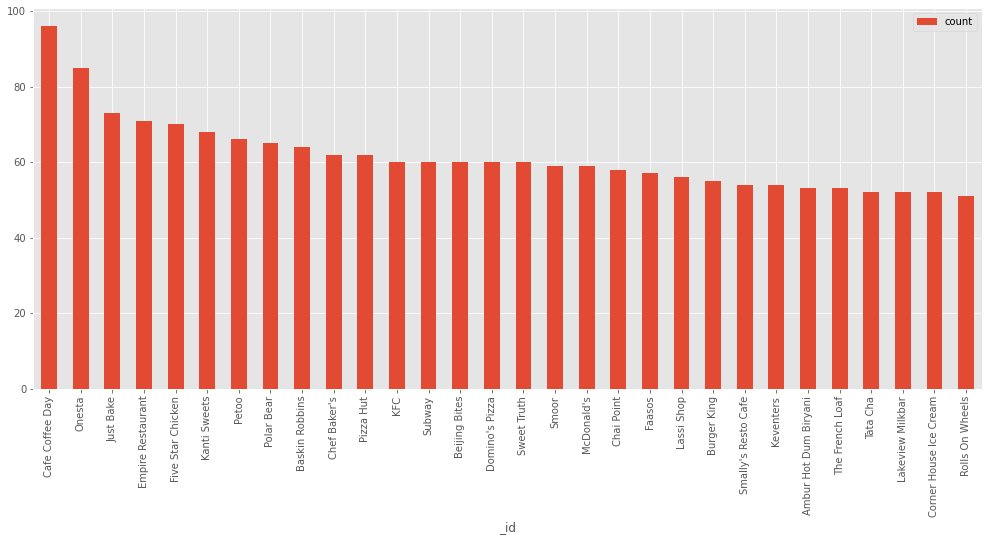

In [50]:
df[0:30].plot(kind = 'bar',x = '_id', y = 'count')

#### i. Top 5 Hotels

In [54]:
q3_agg_result_1=collection.aggregate([{ "$group": {"_id": "$name","count": { "$sum": 1 } } },
                                 {"$sort": { "count": -1 }},
                                   {"$limit": 5}])
list(q3_agg_result_1)

[{'_id': 'Cafe Coffee Day', 'count': 96},
 {'_id': 'Onesta', 'count': 85},
 {'_id': 'Just Bake', 'count': 73},
 {'_id': 'Empire Restaurant', 'count': 71},
 {'_id': 'Five Star Chicken', 'count': 70}]

#### ii. Last 5 Hotels

In [55]:
q3_agg_result_2=collection.aggregate([{ "$group": {"_id": "$name","count": { "$sum": 1 } } },
                                 {"$sort": { "count": 1 }},
                                   {"$limit": 5}])
list(q3_agg_result_2)

[{'_id': 'Mark', 'count': 1},
 {'_id': 'Food Express', 'count': 1},
 {'_id': 'Chokha Zaika', 'count': 1},
 {'_id': 'Hotel Panchami Grand', 'count': 1},
 {'_id': 'The Bengal Rasoi', 'count': 1}]

#### Inference
    - Sales in each hotel.
    - Which hotels has highest number of customers
    - Cafe Coffee Day, Onesta , Just Bake has the highest number of customers whereas Nandini Dosa Camp , Terracotta Whitefield , Bhavani Military Hotel has the least sales

### 4.Number of votes for each hotel

In [58]:
q4_agg_result=collection.aggregate([{ "$group": {"_id": "$name","votes": { "$sum": "$votes" } } },
                                 {"$sort": { "votes": -1 }}])


In [57]:
(list(q4_agg_result))

[{'_id': 'Onesta', 'votes': 347520},
 {'_id': 'Truffles', 'votes': 301059},
 {'_id': 'Empire Restaurant', 'votes': 229808},
 {'_id': 'Hammered', 'votes': 180602},
 {'_id': 'The Black Pearl', 'votes': 172122},
 {'_id': 'Meghana Foods', 'votes': 129557},
 {'_id': 'Barbeque Nation', 'votes': 108425},
 {'_id': "Smally's Resto Cafe", 'votes': 102877},
 {'_id': 'Byg Brewski Brewing Company', 'votes': 99531},
 {'_id': "Gilly's Restobar", 'votes': 98808},
 {'_id': 'Arbor Brewing Company', 'votes': 92362},
 {'_id': 'House Of Commons', 'votes': 90573},
 {'_id': 'Chutney Chang', 'votes': 89910},
 {'_id': "Fenny's Lounge And Kitchen", 'votes': 89183},
 {'_id': "AB's - Absolute Barbecues", 'votes': 86418},
 {'_id': 'Church Street Social', 'votes': 83179},
 {'_id': 'Prost Brew Pub', 'votes': 78609},
 {'_id': 'The Biere Club', 'votes': 76649},
 {'_id': 'Stoner', 'votes': 75194},
 {'_id': 'Koramangala Social', 'votes': 75021},
 {'_id': 'Barleyz', 'votes': 74448},
 {'_id': 'The Boozy Griffin', 'votes':

In [59]:
df = pd.DataFrame(q4_agg_result)
df

,_id,votes
0,Onesta,347520
1,Truffles,301059
2,Empire Restaurant,229808
3,Hammered,180602
4,The Black Pearl,172122
...,...,...
8787,Let's Bounce,0
8788,Dilli Tadka,0
8789,BMR Cafe,0
8790,4-States,0


<AxesSubplot:xlabel='_id'>

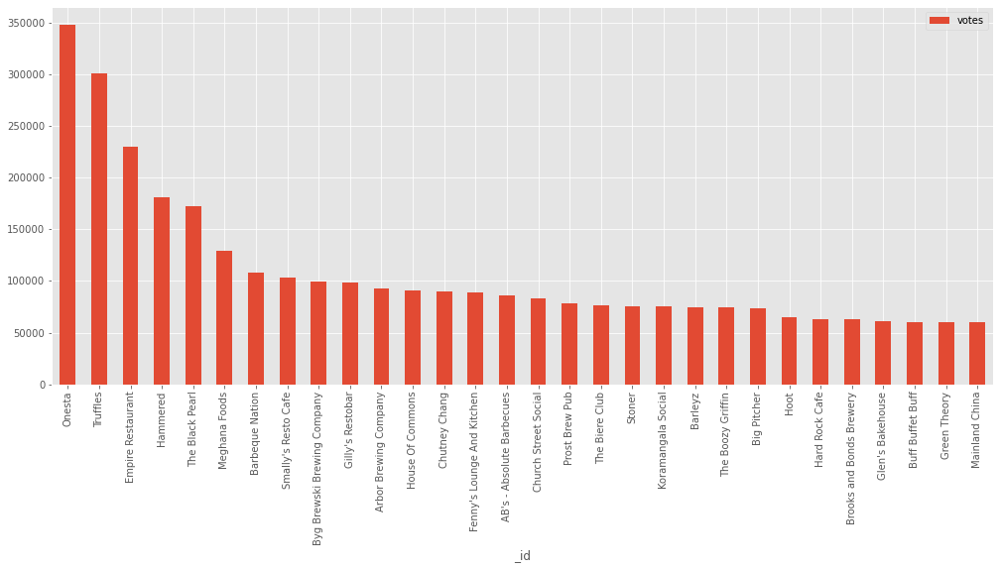

In [60]:
df[0:30].plot(kind = 'bar',x = '_id', y = 'votes')

#### i. Top 5 highly voted Hotels

In [61]:
q4_agg_result_1=collection.aggregate([{ "$group": {"_id": "$name","votes": { "$sum": "$votes" } } },
                                 {"$sort": { "votes": -1 }},
                                   {"$limit": 5}])
list(q4_agg_result_1)

[{'_id': 'Onesta', 'votes': 347520},
 {'_id': 'Truffles', 'votes': 301059},
 {'_id': 'Empire Restaurant', 'votes': 229808},
 {'_id': 'Hammered', 'votes': 180602},
 {'_id': 'The Black Pearl', 'votes': 172122}]

#### ii. Last 5 Hotels

In [62]:
q4_agg_result_2=collection.aggregate([{ "$group": {"_id": "$name","votes": { "$sum": "$votes" } } },
                                 {"$sort": { "votes": 1 }},
                                   {"$limit": 5}])
list(q4_agg_result_2)

[{'_id': 'Ofoodz', 'votes': 0},
 {'_id': 'United Cafe & Fastfood', 'votes': 0},
 {'_id': 'Hotel Green Palace', 'votes': 0},
 {'_id': 'Chef Genie', 'votes': 0},
 {'_id': 'Next Corner', 'votes': 0}]

#### Inference
    - Counts of the votes for each orders wrt hotels.
    - Onesta, Truffles , Empire Restaurant are getting high votes but Zuiqa Taste, Nourich, Remos Kitchen are having least votes.

### 5. About Menu

#### i. Hotels with menu

In [63]:

q5_1=[]
for rec in collection.find({'menu_item':{'$ne':'[]'}}):
    q5_1.append(rec.get('name'))

print(len(q5_1))
print((q5_1))


12100
['Sweet Truth', 'Faasos', 'Maruthi Davangere Benne Dosa', 'Kitchen Garden', 'Recipe', 'Tasty Bytes', 'Shree Cool Point', 'FreshMenu', "Namma Brahmin's Idli", 'Sri Guru Kottureshwara Davangere Benne Dosa', 'Bengaluru Coffee House', 'Anna Kuteera', 'Vijayalakshmi', 'Sri Udupi Food Hub', 'Udupi Upahar', "New Gowda's Fried Chicken", 'HOT COFFEE', 'Sagar Deluxe', 'Grazers', 'By 2 Coffee', 'Davangere Butter Dosa Hotel', 'Mulabagilu Dosa', 'Udupi Ruchi', 'Cool Corner', 'Matru Sagar', 'In Time Cane Juice', 'Srikrishna Bhavan', 'Chumma Delicious', 'SSV Upahar', 'Dwaraka Grand', "Tanna's Kitchen", 'Shree Mandarathi Grand', 'South Kitchen', 'Shanthi Sagar', 'Kamat Bugle Rock', 'Puliyogare Point', 'Bangalore Agarwal Bhavan', 'Udupi Ruchi Grand', 'Just Thindi', 'Matru Sagar', 'Vasanth Vihar - Since 1965', 'Mast Punjabi', 'South Grand', 'Dakshin Grand', 'Chai Mane', 'Kaapi Kendra', 'The Krishna Grand Xpress', 'Coffee Tindi', 'Drunken Monkey', 'Lalbagh Grand', 'Sri Krishna Aramane', 'Swarga Ruc

#### ii. Hotels without menu

In [64]:
#5.2 hotels without menu
q5_2=[]
for rec in collection.find({'menu_item':{'$eq':'[]'}}):
    q5_2.append(rec.get('name'))

print(len(q5_2))
print((q5_2))

39617
['Jalsa', 'Spice Elephant', 'San Churro Cafe', 'Addhuri Udupi Bhojana', 'Grand Village', 'Timepass Dinner', 'Rosewood International Hotel - Bar & Restaurant', 'Onesta', 'Penthouse Cafe', 'Smacznego', 'CafÃ\x83Â\x83Ã\x82Â\x83Ã\x83Â\x82Ã\x82Â\x83Ã\x83Â\x83Ã\x82Â\x82Ã\x83Â\x82Ã\x82Â© Down The Alley', 'Cafe Shuffle', 'The Coffee Shack', 'Caf-Eleven', 'San Churro Cafe', 'Cafe Vivacity', 'Catch-up-ino', "Kirthi's Biryani", 'T3H Cafe', '360 Atoms Restaurant And Cafe', 'The Vintage Cafe', 'Woodee Pizza', 'Cafe Coffee Day', 'My Tea House', 'Hide Out Cafe', 'CAFE NOVA', 'Coffee Tindi', 'Sea Green Cafe', 'Cuppa', "Srinathji's Cafe", 'Redberrys', 'Foodiction', 'Ovenstory Pizza', 'Behrouz Biryani', 'Fast And Fresh', 'Szechuan Dragon', 'Empire Restaurant', 'Chaatimes', 'Havyaka Mess', "McDonald's", "Domino's Pizza", 'Onesta', 'Hotboxit', 'Beijing Bites', 'Petoo', 'Corner House Ice Cream', 'Biryanis And More', 'Roving Feast', 'Banashankari Donne Biriyani', 'Wamama', 'Five Star Chicken', 'XO Bel

#### Inference
    - In this data there are hotels with menu and without menu so we can separate it request them to give their menu.
    - 12100 hotels are having menu.
    - 39617 hotels are not having their menu.

### 6. About table booking and online ordering

In [67]:
q6_agg_result=collection.aggregate([{ "$group": {"_id": {"booking table": "$book_table","online order": "$online_order"},"count": { "$addToSet": "$name" } }},
                                   {"$sort": { "_id": -1 }}])

In [66]:
list(q6_agg_result)

[{'_id': {'booking table': 'Yes', 'online order': 'Yes'},
  'count': ['Tap House Resto Bar',
   'Biriyani House',
   'Desi Cream Junction',
   'China Bistro & Lounge',
   'Dice N Dine',
   'Two Friends Cauldron',
   'Enchanted Garden',
   'Banana Beach Bar',
   'Orzuv',
   'The Tao Terraces',
   'Tangerine - Davanam Sarovar Portico Suites',
   'The Royal Corner - Pai Viceroy',
   "Connie's Restaurant & Steakhouse",
   'Melt - Eden Park',
   'Tandoor',
   'Konaseema Kitchen',
   'Vaathsalya Millet Cafe',
   'The Twisted Desi',
   'Fabcafe',
   'Punjabi by Nature 2.0',
   'Brew and Barbeque - A Microbrewery Pub',
   'Nasi And Mee',
   'New Leaf Restaurant',
   'Chakh Le Foods',
   'Zamindar',
   'Pind Balluchi',
   'Tipsy Bull - The Bar Exchange',
   'Cita Pani',
   'Ajwa Thalassery Biryani',
   'Purnabramha Maharashtrian Restaurant',
   'Bella',
   'Global Flavors',
   'Chung Wah',
   'Ebony',
   'Le Arabia',
   'Mamagoto',
   'Plated',
   '@ The Bbq',
   'Imperio Restaurant',
   'Parik

In [68]:
for res in list(q6_agg_result):
    print(res.get('_id'),len(res.get('count')))

{'booking table': 'Yes', 'online order': 'Yes'} 427
{'booking table': 'Yes', 'online order': 'No'} 418
{'booking table': 'No', 'online order': 'Yes'} 4047
{'booking table': 'No', 'online order': 'No'} 4798


#### Inference
    - From this we can get Booking and Online ordering information

### 7. Number of orders in each hotel in each Area in Bangalore

In [69]:
q7_agg_result= collection.aggregate([{"$group": {"_id": {"name":"$name" ,"location":"$location" },"count": { "$sum": 1 }}},
                                    {"$sort": { "count": -1 }}])

list(q7_agg_result)

[{'_id': {'name': 'Hammered', 'location': 'Cunningham Road'}, 'count': 34},
 {'_id': {'name': 'Dolci Desserts', 'location': 'Cunningham Road'},
  'count': 25},
 {'_id': {'name': 'The Chocolate Heaven', 'location': 'Commercial Street'},
  'count': 24},
 {'_id': {'name': 'Tiger Trail - Ramada Hotel', 'location': 'Shivajinagar'},
  'count': 23},
 {'_id': {'name': 'ThrowBack - Pub & Dine', 'location': 'Langford Town'},
  'count': 22},
 {'_id': {'name': 'Hatti Punjab Di', 'location': 'Brigade Road'}, 'count': 22},
 {'_id': {'name': 'Berrylicious Cafe', 'location': 'MG Road'}, 'count': 22},
 {'_id': {'name': 'Fresh Pressery Cafe', 'location': 'Koramangala 5th Block'},
  'count': 21},
 {'_id': {'name': 'Bonsouth', 'location': 'Koramangala 5th Block'},
  'count': 21},
 {'_id': {'name': 'Bistro Claytopia', 'location': 'Koramangala 1st Block'},
  'count': 21},
 {'_id': {'name': 'Stoner', 'location': 'Koramangala 5th Block'}, 'count': 21},
 {'_id': {'name': 'Cilantro', 'location': 'Koramangala 4t

#### i. Top 5  orders in Hotels w.r.t towns

In [70]:
q7_agg_result_1= collection.aggregate([{"$group": {"_id": {"name":"$name" ,"location":"$location" },"count": { "$sum": 1 }}},
                                    {"$sort": { "count": -1 }},
                                    {"$limit": 5}])

list(q7_agg_result_1)

[{'_id': {'name': 'Hammered', 'location': 'Cunningham Road'}, 'count': 34},
 {'_id': {'name': 'Dolci Desserts', 'location': 'Cunningham Road'},
  'count': 25},
 {'_id': {'name': 'The Chocolate Heaven', 'location': 'Commercial Street'},
  'count': 24},
 {'_id': {'name': 'Tiger Trail - Ramada Hotel', 'location': 'Shivajinagar'},
  'count': 23},
 {'_id': {'name': 'Hatti Punjab Di', 'location': 'Brigade Road'}, 'count': 22}]

#### ii. Least 5  orders in Hotels w.r.t towns

In [71]:
# 7 hotels in each town
q7_agg_result_2= collection.aggregate([{"$group": {"_id": {"name":"$name" ,"location":"$location" },"count": { "$sum": 1 }}},
                                    {"$sort": { "count": 1 }},
                                    {"$limit": 5}])

list(q7_agg_result_2)

[{'_id': {'name': 'Tasty Castle', 'location': 'New BEL Road'}, 'count': 1},
 {'_id': {'name': 'Maa Sharda Hotel', 'location': 'Electronic City'},
  'count': 1},
 {'_id': {'name': 'Calcutta North Indian Meals', 'location': 'Whitefield'},
  'count': 1},
 {'_id': {'name': 'Pavitra Paradise', 'location': 'Basaveshwara Nagar'},
  'count': 1},
 {'_id': {'name': 'Reddy Hotel', 'location': 'Sarjapur Road'}, 'count': 1}]

#### Inference
    - Sales in each town in Banglore

### 8. Available cuisines

In [33]:
# 8 most available cuisins
q8_agg_result= collection.aggregate([{"$group": {"_id":"$cuisines"}}])
q8=[]
for res in list(q8_agg_result):
    q8.append(res.get('_id'))


In [34]:
q8=np.array(q8)
q8_1=np.array([])
for i in range(len(q8)):
    q8i=q8[i]
    q8_1=np.append(q8_1,(np.array(str(q8i).split(", "))))
dfq8 = pd.DataFrame({'cusins':q8_1})
x=(dfq8['cusins'].value_counts())
x=x.to_frame()
x=x.set_axis(['no. of counts'], axis=1, inplace=False)

In [35]:
x

,no. of counts
North Indian,1208
Chinese,1027
Fast Food,554
Continental,543
South Indian,497
...,...
Indian,1
Australian,1
Raw Meats,1
Sindhi,1


<AxesSubplot:>

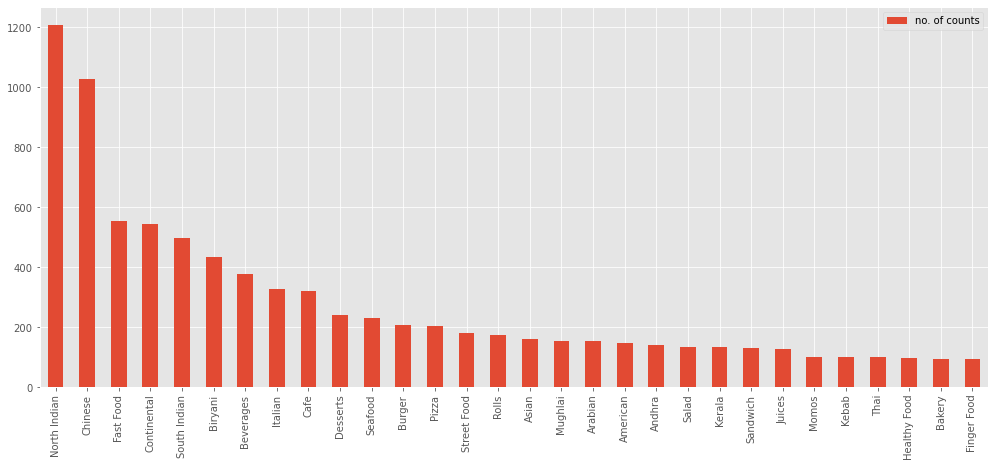

In [41]:
x[0:30].plot(kind = 'bar', y = 'no. of counts')

<AxesSubplot:>

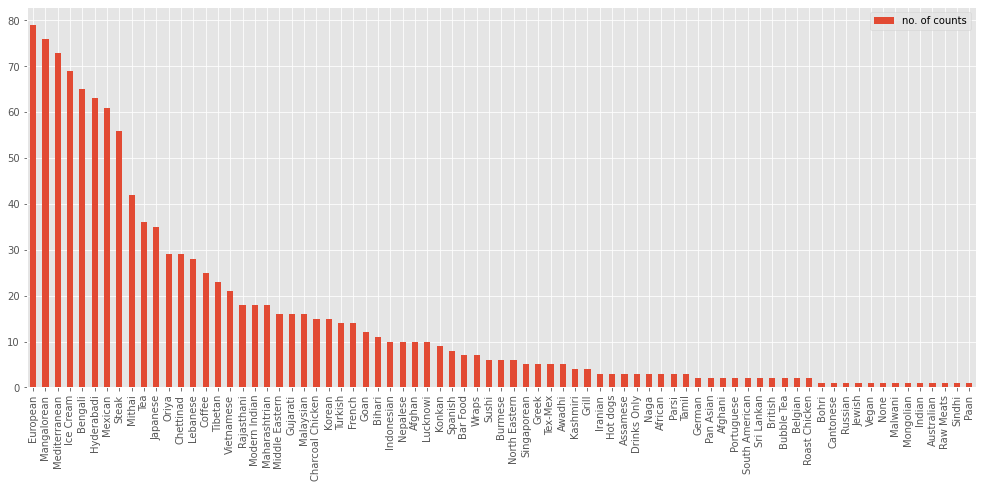

In [42]:
x[31:].plot(kind = 'bar', y = 'no. of counts')

#### i. Top 5 cuisines

In [77]:
x.head(5)

,no. of counts
North Indian,1208
Chinese,1027
Fast Food,554
Continental,543
South Indian,497


#### ii. Least 5 cuisines

In [78]:
x.tail(5)

,no. of counts
Raw Meats,1
None,1
Cantonese,1
Russian,1
Bohri,1


#### Inference
    - Availablity of cusins in Banglore

### 9. Cost efficient And Quality hotels

In [79]:
q9_agg_result= collection.aggregate([{"$group": {"_id":"$name" ,"rating": { "$addToSet":"$rate" },"approx_cost": { "$avg":"$approx_cost(for two people)"} }},
                                      {"$sort": { "_id": -1 }}])
    
val9=[]
for res in list(q9_agg_result):
    l2=[]
    for i in (list(res.get('rating'))):
#         print(i)
        if(i!=None):
            if "/" in i:
                l2.append(float(i.split( "/" )[0]))
    val9.append([res.get('_id'),l2,res.get('approx_cost')])   
    
    
q9_1=[]
for i in val9:
    if (len(i[1])!=0):
        q9_1.append([i[0],round(np.average(i[1]),2),i[2]])
        
        
df=pd.DataFrame(q9_1)
# df.head(5)
df.columns=['name','rating','cost (two persons)']
df=df.dropna()
df.sort_values(by=['rating','cost (two persons)'],ascending=[False,True], na_position = 'first')

,name,rating,cost (two persons)
6016,Belgian Waffle Factory,4.85,400.0
2487,O.G. Variar & Sons,4.80,200.0
5683,CTR,4.75,150.0
1018,Taaza Thindi,4.70,100.0
2960,Milano Ice Cream,4.70,400.0
...,...,...,...
2998,Meghana Biryani,2.30,800.0
5979,Bhagini,2.28,800.0
953,Taste Of Kerala,2.23,600.0
6140,Bageecha,2.15,650.0


array([<AxesSubplot:title={'center':'rating'}, xlabel='name'>,
       <AxesSubplot:title={'center':'cost (two persons)'}, xlabel='name'>],
      dtype=object)

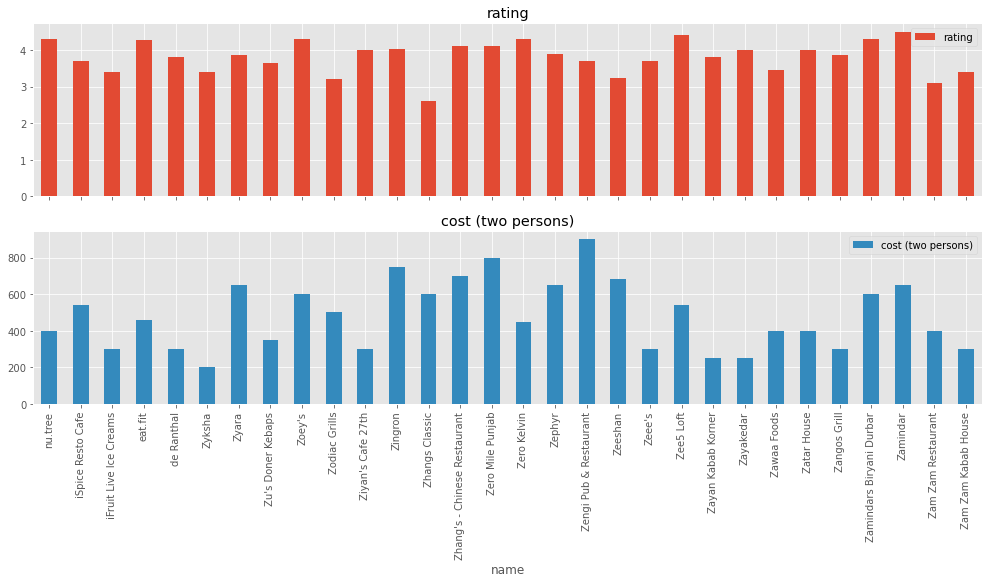

In [80]:
df[0:30].plot(subplots=True,kind = 'bar',x='name')

In [81]:
#thresolds
high_rating=4.5
low_rating =3.5
high_cost = 500
low_cost=500

#### i. Best hotels 
##### (high rating (> 4.5), low cost (<500)) 

In [82]:
df[(df['rating'] > high_rating) & (df['cost (two persons)'] <low_cost)]

,name,rating,cost (two persons)
600,The Pancake Story,4.60,300.0
817,The Blue Wagon - Kitchen,4.60,400.0
1018,Taaza Thindi,4.70,100.0
2487,O.G. Variar & Sons,4.80,200.0
2845,Mugful Of Stories,4.60,300.0
2960,Milano Ice Cream,4.70,400.0
3416,Kurtoskalacs,4.65,390.0
4893,Dock Frost'd,4.60,400.0
5683,CTR,4.75,150.0
6016,Belgian Waffle Factory,4.85,400.0


#### ii. Average hotels 
##### (low rating (<3.5), high cost (>500)) & (high rating (>4.5), high cost (>500))

In [83]:
df[((df['rating'] < low_rating) & (df['cost (two persons)'] >low_cost))|((df['rating'] > high_rating) & (df['cost (two persons)'] >high_cost))].sort_values(by=['rating','cost (two persons)'],ascending=[False,False], na_position = 'first')

,name,rating,cost (two persons)
4825,ECHOES Koramangala,4.70,750.0
3257,Lot Like Crepes,4.63,550.0
401,Truffles,4.60,900.0
6151,Baar Union,4.60,850.0
4225,Here & Now,4.60,750.0
...,...,...,...
2131,Punjabi Daawat,2.40,550.0
2998,Meghana Biryani,2.30,800.0
5979,Bhagini,2.28,800.0
953,Taste Of Kerala,2.23,600.0


#### iii. Below Average hotels 
#####               (low rating(<3.5), low cost(<500))

In [84]:
df[(df['rating'] < low_rating) & (df['cost (two persons)'] <low_cost)]

,name,rating,cost (two persons)
3,iFruit Live Ice Creams,3.40,300.0
9,Zyksha,3.40,200.0
30,Zawaa Foods,3.45,400.0
36,Zam Zam Restaurant,3.10,400.0
37,Zam Zam Kabab House,3.40,300.0
...,...,...,...
6614,360 Atoms Restaurant And Cafe,3.10,400.0
6622,24/7 Food Service,2.95,300.0
6634,1980s Games Cafe,3.40,400.0
6645,1000 B.C,3.20,300.0


### 10. About Rest type

In [87]:
q10_agg_res = collection.aggregate([{"$group": {"_id":{"name":"$name" },"rest type": { "$addToSet":"$rest_type" }}},
                                   ])

In [86]:
((list(q10_agg_res)))

[{'_id': {'name': 'Amrutha Foods'}, 'rest type': ['Quick Bites']},
 {'_id': {'name': 'Hotel Triloka'}, 'rest type': ['Quick Bites']},
 {'_id': {'name': 'Singh Saheb Di Rasoi'}, 'rest type': ['Quick Bites']},
 {'_id': {'name': 'Multi Cakes'}, 'rest type': ['Dessert Parlor', 'Bakery']},
 {'_id': {'name': 'Shanmukha'},
  'rest type': ['Casual Dining', 'Takeaway, Delivery']},
 {'_id': {'name': "Priya's Punjabi"}, 'rest type': ['Casual Dining']},
 {'_id': {'name': 'Al-Madina'}, 'rest type': ['Takeaway, Delivery']},
 {'_id': {'name': 'Cream Chemistry'}, 'rest type': ['Dessert Parlor']},
 {'_id': {'name': 'Captain Egg'}, 'rest type': ['Food Court']},
 {'_id': {'name': 'Momo Blues'}, 'rest type': ['Quick Bites']},
 {'_id': {'name': "Kushal's Kitchen"}, 'rest type': ['Casual Dining']},
 {'_id': {'name': 'Taja Coffee'}, 'rest type': ['Quick Bites']},
 {'_id': {'name': 'KFC'},
  'rest type': ['Food Court',
   'Quick Bites, Food Court',
   'Quick Bites',
   'Food Court, Quick Bites']},
 {'_id': {'

In [88]:
for res in list(q10_agg_res):
     if (len(res.get('rest type'))>1):
            print(res.get('_id'),len(res.get('rest type'))) 

{'name': 'Shivaji Military Hotel'} 2
{'name': 'Royal Calcutta Restaurant'} 2
{'name': 'Mojo Pizza - 2X Toppings'} 3
{'name': '99 Pancakes'} 2
{'name': 'Chaai Resto'} 4
{'name': 'Jigarthanda'} 2
{'name': 'Suvai Factory'} 2
{'name': 'Five Star Chicken'} 2
{'name': 'Star Bowl'} 2
{'name': 'The Grill House'} 2
{'name': 'GrannyzHut'} 2
{'name': 'Veruthe Oru Thattukada'} 2
{'name': 'Kerala Kitchen'} 2
{'name': 'Cafe Longing'} 2
{'name': 'Chicken Man'} 2
{'name': 'New Tandoori Point'} 2
{'name': 'Nandhini Paradise'} 2
{'name': "TFC - Tony's Food Corner"} 2
{'name': 'Sweet Chariot'} 3
{'name': 'CakeWalk'} 2
{'name': 'Karachi Bakery'} 2
{'name': 'Bootlegger'} 2
{'name': 'Chaat Street'} 2
{'name': 'Biryani Kitchen'} 2
{'name': 'BJM Restaurant & Cafe'} 2
{'name': 'Food Mood'} 2
{'name': 'Nawab-E-Khana'} 2
{'name': 'Annapurna Bengali Restaurant'} 2
{'name': 'Biryani Treat'} 2
{'name': "Kollapuri's"} 2
{'name': 'Coffee Tea & More'} 2
{'name': 'Food Theory'} 3
{'name': 'Mustard Food Court'} 2
{'name

#### Collecting data wrt hotel names

In [89]:
q10_agg_res_1 = collection.aggregate([ { "$match": { "name": 'Lassi Magic' } },{"$group": {"_id":{"name":"$name" },"rest type": { "$addToSet":"$rest_type" }}},
                                   ])

In [90]:
(list(q10_agg_res_1))

[{'_id': {'name': 'Lassi Magic'},
  'rest type': ['Beverage Shop', 'Quick Bites']}]

#### Collecting data wrt Rest type

In [91]:
q10_agg_res_2 = collection.aggregate([ { "$match": { "rest_type": 'Beverage Shop' } },{"$group": {"_id":{"rest_type":"$rest_type" },"name": { "$addToSet":"$name" }}},
                                   ])

In [92]:
(list(q10_agg_res_2))

[{'_id': {'rest_type': 'Beverage Shop'},
  'name': ['Chill Out',
   'Juice Buzz',
   'Roots n Fruits',
   'Lassi Darbar',
   'The Crunch',
   'Chill Magic',
   'Xpress Chai',
   'Juicy Juice',
   'Aha Juice Bar',
   'Sabari Juice Junction',
   'Oyo Empire Juice Shop',
   'Sree Gajanana Juice Centre',
   'Tenco Infusions',
   'Lassi Corner',
   'Juicy',
   'Sri Ganesh Fruit Juice Centre',
   'Sandy Cool Joint',
   'AlienSip',
   'Doctor Juice',
   'Only Sharjah',
   'Dessi Cuppa',
   'Squeez Juice Bars',
   'Choconut',
   'Quick Shakes & More',
   'Shake N Snack',
   'Shake it Off',
   'Lassi Point',
   'You N Cane',
   'Priya Juice & Snacks',
   'Chaai Resto',
   'Jugo Fresh',
   'Ice Cafe & Lassi Shop',
   'Krishu Juice Centre',
   'Zaitoon Lassi Cafe',
   'The Lassi Bar',
   'F Juice',
   'Lassi Magic',
   'Sri Ganesh Juice Junction',
   'Lassi Adda',
   'Juice Lounge',
   'Lassi Shop',
   'Just Chill',
   'Smooth Blender',
   'Jambudweepa Juice Bar',
   'Kettle & Kegs',
   'Crazy Cr

### 11. Best rated hotels

In [44]:
q11_agg_res = collection.aggregate([{"$group": {"_id":"$name","rating": { "$addToSet":"$rate" },"value": { "$sum": "$votes" }}},
                                   {"$sort": { "value":-1}}])

In [94]:
list(q11_agg_res)

[{'_id': 'Onesta',
  'rating': ['4.5/5', '4.3 /5', '4.4/5', '4.4 /5', '4.3/5', '4.6/5', '4.6 /5'],
  'value': 347520},
 {'_id': 'Truffles',
  'rating': ['4.7/5', '4.6/5', '4.7 /5', '4.5 /5', '4.5/5'],
  'value': 301059},
 {'_id': 'Empire Restaurant',
  'rating': ['3.6/5',
   '3.9 /5',
   '4.4/5',
   '3.6 /5',
   'NEW',
   '4.4 /5',
   '4.3/5',
   '4.1 /5',
   '4.0 /5',
   '3.5 /5',
   '4.0/5',
   '3.8/5',
   '4.2/5',
   '3.8 /5',
   '3.7 /5',
   '3.5/5',
   '3.9/5',
   '4.1/5'],
  'value': 229808},
 {'_id': 'Hammered',
  'rating': ['4.7/5', 'NEW', '4.4 /5', '4.7 /5', '4.6 /5', '4.3 /5', '4.5 /5'],
  'value': 180602},
 {'_id': 'The Black Pearl',
  'rating': ['4.7/5', '4.8 /5', '4.7 /5', '4.8/5'],
  'value': 172122},
 {'_id': 'Meghana Foods',
  'rating': ['4.2/5',
   '4.4/5',
   '4.5 /5',
   '4.3 /5',
   '4.5/5',
   '4.2 /5',
   '4.3/5',
   '4.4 /5'],
  'value': 129557},
 {'_id': 'Barbeque Nation',
  'rating': ['4.2 /5',
   '4.7 /5',
   '4.8 /5',
   '4.5 /5',
   '4.7/5',
   '4.4 /5',
   

In [45]:
val11=[]
for res in list(q11_agg_res):
    l2=[]
    for i in (list(res.get('rating'))):
#         print(i)
        if(i!=None):
            if "/" in i:
                l2.append(float(i.split( "/" )[0]))
    val11.append([res.get('_id'),l2,res.get('value')])   
    
    
q111=[]
for i in val11:
    if (len(i[1])!=0):
        q111.append([i[0],round(np.average(i[1]),2),i[2]])
        
       
df=pd.DataFrame(q111)
df.columns=['name','rating','votes'] 
df=df.dropna()

In [46]:
df

,name,rating,votes
0,Onesta,4.44,347520
1,Truffles,4.60,301059
2,Empire Restaurant,3.93,229808
3,Hammered,4.53,180602
4,The Black Pearl,4.75,172122
...,...,...,...
6644,Ilyazsab Shawarma Cafe,3.60,0
6645,Sri Brahmi Kuteera,3.40,0
6646,Wudfyr,3.80,0
6647,Nourich,3.90,0


In [47]:
df.sort_values(by=['rating','votes'],ascending=[False,False], na_position = 'first')

,name,rating,votes
8,Byg Brewski Brewing Company,4.90,99531
57,Asia Kitchen By Mainland China,4.90,42273
3065,SantÃÂÃÂÃÂÃÂÃÂÃÂÃÂÃÂÃÂÃÂÃ...,4.90,246
315,Punjab Grill,4.87,9660
117,Belgian Waffle Factory,4.85,24882
...,...,...,...
530,Mamma Mexicana,2.20,5296
1082,Bageecha,2.15,1916
1606,Decker's Lane,2.10,970
707,Fusion Lounge,2.00,3573


array([<AxesSubplot:title={'center':'rating'}, xlabel='name'>,
       <AxesSubplot:title={'center':'votes'}, xlabel='name'>],
      dtype=object)

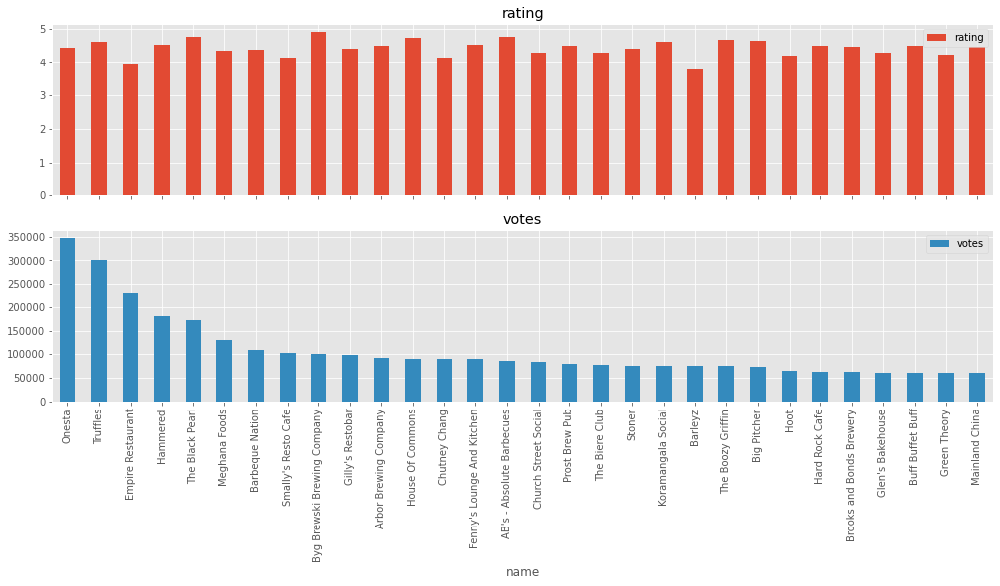

In [99]:
df[0:30].plot(subplots=True,kind = 'bar',x='name')

In [100]:
#thresolds
high_rating=4.5
low_rating =3.5
high_votes = 50000
low_votes=10000

#### i. more than 4.5 stars and 50k votes

In [101]:
df[(df['rating'] > high_rating) & (df['votes'] > high_votes)]

,name,rating,votes
1,Truffles,4.60,301059
3,Hammered,4.53,180602
4,The Black Pearl,4.75,172122
8,Byg Brewski Brewing Company,4.90,99531
11,House Of Commons,4.73,90573
13,Fenny's Lounge And Kitchen,4.53,89183
14,AB's - Absolute Barbecues,4.77,86418
19,Koramangala Social,4.60,75021
21,The Boozy Griffin,4.67,74332
22,Big Pitcher,4.65,73316


#### ii. less than 3. stars and 10k votes

In [102]:
df[(df['rating'] < low_rating) & (df['votes'] < low_votes)]

,name,rating,votes
330,Delhi Food Point,3.30,9107
333,Mast Kalandar,2.36,9002
340,Abhiruchi Hotel,3.36,8817
342,Subway,3.36,8744
344,On The Nose,3.25,8707
...,...,...,...
6636,4K Biryani,3.30,4
6637,4 States,3.20,4
6638,Dilli6 Paratha,3.00,4
6640,Desi Aahar,3.30,0


#### Inference
    - From this we can get Best rated hotels in the city
    - Quality of the hotels lies in number of votes and rating
    - So wrt stars and votes thresolds we classified the hotels into 3 types
    

### RECOMMANDATION SYSTEM

In [86]:
import numpy as np
import pandas as pd
import warnings
warnings.filterwarnings('always')
warnings.filterwarnings('ignore')
import re
from nltk.corpus import stopwords
from sklearn.metrics.pairwise import linear_kernel
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.feature_extraction.text import TfidfVectorizer

In [87]:
zomato_real= collection.aggregate([{"$project": {"name":"$name" ,"approx_cost(for two people)":"$approx_cost(for two people)",
                                            "rate":"$rate","reviews_list":"$reviews_list","cuisines":"$cuisines"}}])


In [84]:
list(zomato_real)

[{'_id': ObjectId('619b5fac486e6853175307ca'),
  'name': 'Jalsa',
  'approx_cost(for two people)': 800,
  'rate': '4.1/5',
  'reviews_list': '[(\'Rated 4.0\', \'RATED\\n  A beautiful place to dine in.The interiors take you back to the Mughal era. The lightings are just perfect.We went there on the occasion of Christmas and so they had only limited items available. But the taste and service was not compromised at all.The only complaint is that the breads could have been better.Would surely like to come here again.\'), (\'Rated 4.0\', \'RATED\\n  I was here for dinner with my family on a weekday. The restaurant was completely empty. Ambience is good with some good old hindi music. Seating arrangement are good too. We ordered masala papad, panner and baby corn starters, lemon and corrionder soup, butter roti, olive and chilli paratha. Food was fresh and good, service is good too. Good for family hangout.\\nCheers\'), (\'Rated 2.0\', \'RATED\\n  Its a restaurant near to Banashankari BDA. M

In [88]:
zomato_real=pd.DataFrame(zomato_real)

In [89]:
zomato_real.head()

,_id,name,approx_cost(for two people),rate,reviews_list,cuisines
0,619b5fac486e6853175307ca,Jalsa,800,4.1/5,"[('Rated 4.0', 'RATED\n A beautiful place to ...","North Indian, Mughlai, Chinese"
1,619b5fac486e6853175307cb,Spice Elephant,800,4.1/5,"[('Rated 4.0', 'RATED\n Had been here for din...","Chinese, North Indian, Thai"
2,619b5fac486e6853175307cc,San Churro Cafe,800,3.8/5,"[('Rated 3.0', ""RATED\n Ambience is not that ...","Cafe, Mexican, Italian"
3,619b5fac486e6853175307cd,Addhuri Udupi Bhojana,300,3.7/5,"[('Rated 4.0', ""RATED\n Great food and proper...","South Indian, North Indian"
4,619b5fac486e6853175307ce,Grand Village,600,3.8/5,"[('Rated 4.0', 'RATED\n Very good restaurant ...","North Indian, Rajasthani"


Now the next step is data cleaning and feature engineering for this step we need to do a lot of stuff with the data such as:

    Deleting Unnecessary Columns
    Removing the Duplicates
    Remove the NaN values from the dataset
    Changing the column names
    Data Transformations
    Data Cleaning
    Adjust the column names Now, let’s perform all the above steps in our data

In [90]:
#Deleting Unnnecessary Columns
zomato=zomato_real.drop(['_id'],axis=1) #Dropping the column "dish_liked", "phone", "url" and saving the new dataset as "zomato"
# zomato=zomato_real[['name','approx_cost(for two people)','rate','reviews_list','cuisines']]
#Removing the Duplicates
zomato.duplicated().sum()
zomato.drop_duplicates(inplace=True)

#Remove the NaN values from the dataset
zomato.isnull().sum()
zomato.dropna(how='any',inplace=True)

In [ ]:
zomato

In [91]:
#Changing the column names
zomato = zomato.rename(columns={'approx_cost(for two people)':'cost'})

#Some Transformations
zomato['cost'] = zomato['cost'].astype(str) #Changing the cost to string
zomato['cost'] = zomato['cost'].apply(lambda x: x.replace(',','.')) #Using lambda function to replace ',' from cost
zomato['cost'] = zomato['cost'].astype(float)

#Removing '/5' from Rates
zomato = zomato.loc[zomato.rate !='NEW']
zomato = zomato.loc[zomato.rate !='-'].reset_index(drop=True)
remove_slash = lambda x: x.replace('/5', '') if type(x) == np.str else x
zomato.rate = zomato.rate.apply(remove_slash).str.strip().astype('float')

# Adjust the column names
zomato.name = zomato.name.apply(lambda x:x.title())
# zomato.online_order.replace(('Yes','No'),(True, False),inplace=True)
# zomato.book_table.replace(('Yes','No'),(True, False),inplace=True)

## Computing Mean Rating
restaurants = list(zomato['name'].unique())
zomato['Mean Rating'] = 0

for i in range(len(restaurants)):
    zomato['Mean Rating'][zomato['name'] == restaurants[i]] = zomato['rate'][zomato['name'] == restaurants[i]].mean()
    
from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler(feature_range = (1,5))
zomato[['Mean Rating']] = scaler.fit_transform(zomato[['Mean Rating']]).round(2)

In [92]:
zomato.head()

,name,cost,rate,reviews_list,cuisines,Mean Rating
0,Jalsa,800.0,4.1,"[('Rated 4.0', 'RATED\n A beautiful place to ...","North Indian, Mughlai, Chinese",4.00
1,Spice Elephant,800.0,4.1,"[('Rated 4.0', 'RATED\n Had been here for din...","Chinese, North Indian, Thai",3.97
2,San Churro Cafe,800.0,3.8,"[('Rated 3.0', ""RATED\n Ambience is not that ...","Cafe, Mexican, Italian",3.58
3,Addhuri Udupi Bhojana,300.0,3.7,"[('Rated 4.0', ""RATED\n Great food and proper...","South Indian, North Indian",3.45
4,Grand Village,600.0,3.8,"[('Rated 4.0', 'RATED\n Very good restaurant ...","North Indian, Rajasthani",3.58


Now the next step is to perform some text preprocessing steps which include:

    Lower casing
    Removal of Punctuations
    Removal of Stopwords
    Removal of URLs
    Spelling correction

In [93]:
zomato["reviews_list"] = zomato["reviews_list"].str.lower()

## Removal of Puctuations
import string
PUNCT_TO_REMOVE = string.punctuation
def remove_punctuation(text):
    """custom function to remove the punctuation"""
    return text.translate(str.maketrans('', '', PUNCT_TO_REMOVE))

zomato["reviews_list"] = zomato["reviews_list"].apply(lambda text: remove_punctuation(text))

## Removal of Stopwords
from nltk.corpus import stopwords
STOPWORDS = set(stopwords.words('english'))
def remove_stopwords(text):
    """custom function to remove the stopwords"""
    return " ".join([word for word in str(text).split() if word not in STOPWORDS])

zomato["reviews_list"] = zomato["reviews_list"].apply(lambda text: remove_stopwords(text))

## Removal of URLS
def remove_urls(text):
    url_pattern = re.compile(r'https?://\S+|www\.\S+')
    return url_pattern.sub(r'', text)

zomato["reviews_list"] = zomato["reviews_list"].apply(lambda text: remove_urls(text))

zomato[['reviews_list', 'cuisines']].sample(5)


,reviews_list,cuisines
20633,rated 40 ratedn delicious word say place visit...,"Bakery, Cafe, Italian, Desserts"
14804,,"North Indian, South Indian"
9001,rated 45 ratedn visited first time place nice ...,"Indonesian, Thai, Vietnamese, Asian, Chinese, ..."
19032,rated 45 ratedn doesnt savour golas herentaste...,Desserts
19000,rated 30 ratedn itãx83ãx83ãx82ãx83ãx83ãx...,"Fast Food, Rolls"


In [94]:
zomato.head()

,name,cost,rate,reviews_list,cuisines,Mean Rating
0,Jalsa,800.0,4.1,rated 40 ratedn beautiful place dine inthe int...,"North Indian, Mughlai, Chinese",4.00
1,Spice Elephant,800.0,4.1,rated 40 ratedn dinner family turned good choo...,"Chinese, North Indian, Thai",3.97
2,San Churro Cafe,800.0,3.8,rated 30 ratedn ambience good enough pocket fr...,"Cafe, Mexican, Italian",3.58
3,Addhuri Udupi Bhojana,300.0,3.7,rated 40 ratedn great food proper karnataka st...,"South Indian, North Indian",3.45
4,Grand Village,600.0,3.8,rated 40 ratedn good restaurant neighbourhood ...,"North Indian, Rajasthani",3.58


In [95]:
# RESTAURANT NAMES:
restaurant_names = list(zomato['name'].unique())
def get_top_words(column, top_nu_of_words, nu_of_word):
    vec = CountVectorizer(ngram_range= nu_of_word, stop_words='english')
    bag_of_words = vec.fit_transform(column)
    sum_words = bag_of_words.sum(axis=0)
    words_freq = [(word, sum_words[0, idx]) for word, idx in vec.vocabulary_.items()]
    words_freq =sorted(words_freq, key = lambda x: x[1], reverse=True)
    return words_freq[:top_nu_of_words]
    

import pandas

# Randomly sample 60% of your dataframe
df_percent = zomato.sample(frac=0.5)

In [96]:
df_percent.set_index('name', inplace=True)
indices = pd.Series(df_percent.index)

# Creating tf-idf matrix
tfidf = TfidfVectorizer(analyzer='word', ngram_range=(1, 2), min_df=0, stop_words='english')
tfidf_matrix = tfidf.fit_transform(df_percent['reviews_list'])

cosine_similarities = linear_kernel(tfidf_matrix, tfidf_matrix)

In [97]:
df_percent.head()

,cost,rate,reviews_list,cuisines,Mean Rating
name,,,,,
Hyderabadi Bawarchi Multi Cuisine Restaurant,600.0,3.0,rated 40 ratedn ordered delivery today satisfi...,"Biryani, North Indian, Chinese",2.55
Desi Deck,1.3,3.9,rated 40 ratedn went visit double deck due spa...,"Mughlai, North Indian, Desserts",3.71
Chill Out Cafe,350.0,3.5,rated 40 ratedn nhad noticed restaurant many t...,"North Indian, Chinese",3.19
Lassi Shop,200.0,3.9,rated 40 ratedn staying near place frequent vi...,"Beverages, Ice Cream",3.57
Food Springs,400.0,4.0,rated 10 ratedn regret paid 120 reason quantit...,"South Indian, Chinese",3.84


In [98]:
def recommend(name, cosine_similarities = cosine_similarities):
    
    # Create a list to put top restaurants
    recommend_restaurant = []
    
    # Find the index of the hotel entered
    idx = indices[indices == name].index[0]
    
    # Find the restaurants with a similar cosine-sim value and order them from bigges number
    score_series = pd.Series(cosine_similarities[idx]).sort_values(ascending=False)
    
    # Extract top 30 restaurant indexes with a similar cosine-sim value
    top30_indexes = list(score_series.iloc[0:31].index)
    
    # Names of the top 30 restaurants
    for each in top30_indexes:
        recommend_restaurant.append(list(df_percent.index)[each])
    
    # Creating the new data set to show similar restaurants
    df_new = pd.DataFrame(columns=['cuisines', 'Mean Rating', 'cost'])
    
    # Create the top 30 similar restaurants with some of their columns
    for each in recommend_restaurant:
        df_new = df_new.append(pd.DataFrame(df_percent[['cuisines','Mean Rating', 'cost']][df_percent.index == each].sample()))
    
    # Drop the same named restaurants and sort only the top 10 by the highest rating
    df_new = df_new.drop_duplicates(subset=['cuisines','Mean Rating', 'cost'], keep=False)
    df_new = df_new.sort_values(by='cost', ascending=False).head(10)
    
    print('TOP %s RESTAURANTS LIKE %s WITH SIMILAR REVIEWS: ' % (str(len(df_new)), name))
    
    return df_new


In [99]:
restaurant_names

['Jalsa',
 'Spice Elephant',
 'San Churro Cafe',
 'Addhuri Udupi Bhojana',
 'Grand Village',
 'Timepass Dinner',
 'Rosewood International Hotel - Bar & Restaurant',
 'Onesta',
 'Penthouse Cafe',
 'Smacznego',
 'Cafã\x83Â\x83Ã\x82Â\x83Ã\x83Â\x82Ã\x82Â\x83Ã\x83Â\x83Ã\x82Â\x82Ã\x83Â\x82Ã\x82Â© Down The Alley',
 'Cafe Shuffle',
 'The Coffee Shack',
 'Caf-Eleven',
 'Cafe Vivacity',
 'Catch-Up-Ino',
 "Kirthi'S Biryani",
 'T3H Cafe',
 '360 Atoms Restaurant And Cafe',
 'The Vintage Cafe',
 'Woodee Pizza',
 'Cafe Coffee Day',
 'My Tea House',
 'Hide Out Cafe',
 'Cafe Nova',
 'Coffee Tindi',
 'Sea Green Cafe',
 'Cuppa',
 "Srinathji'S Cafe",
 'Redberrys',
 'Foodiction',
 'Sweet Truth',
 'Ovenstory Pizza',
 'Faasos',
 'Behrouz Biryani',
 'Fast And Fresh',
 'Szechuan Dragon',
 'Empire Restaurant',
 'Maruthi Davangere Benne Dosa',
 'Chaatimes',
 'Havyaka Mess',
 "Mcdonald'S",
 "Domino'S Pizza",
 'Hotboxit',
 'Kitchen Garden',
 'Recipe',
 'Beijing Bites',
 'Tasty Bytes',
 'Petoo',
 'Shree Cool Point'

In [73]:
recommend("Sultan'S Biryani")     

TOP 8 RESTAURANTS LIKE Sultan'S Biryani WITH SIMILAR REVIEWS: 


,cuisines,Mean Rating,cost
Sultan'S Biryani,"Biryani, North Indian",2.52,700.0
Ambur Biriyani Classic,"Biryani, South Indian, North Indian",2.94,700.0
Pot Biryani,"North Indian, Chinese, Biryani, Seafood",3.27,600.0
Pallavi Restaurant,"Biryani, Chinese, Andhra",3.58,500.0
Night Food Joint,"North Indian, Chinese",2.37,500.0
Foodiction,"North Indian, Fast Food, Chinese, Burger",2.35,500.0
Pot Biryani,"North Indian, Chinese, Biryani",3.27,450.0
Mast Punjabi,"North Indian, Chinese, Rolls, Biryani, Kebab",2.03,400.0


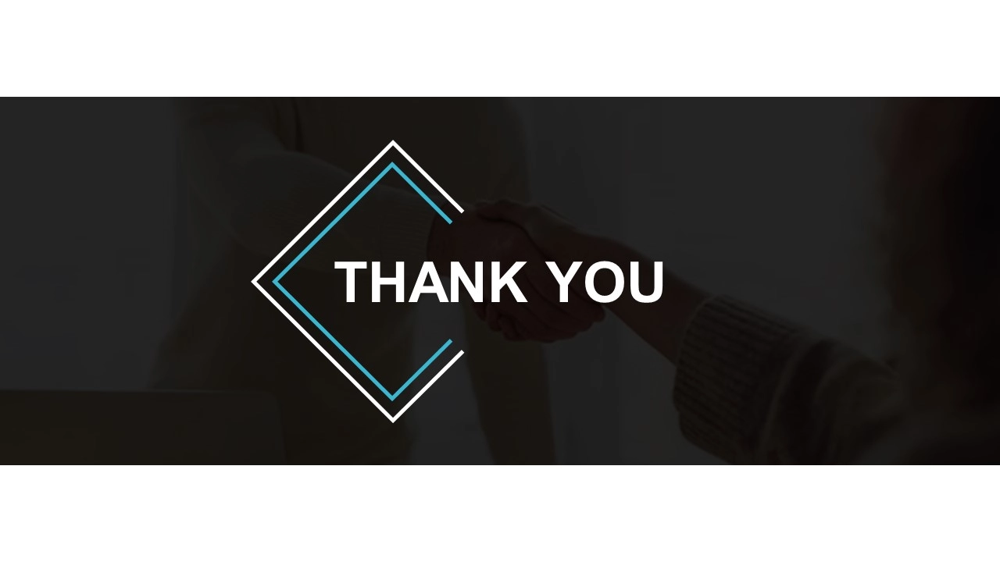